In [78]:
# EJERCICIO N°1:

In [1]:
peruMapaLink = "https://github.com/thiagoDali/preprocesamientoPeru/raw/main/mapas/peruMapa24891_.gpkg"

from  fiona import listlayers


# leemos los layers presentes en "peruMapaLink"
listlayers(peruMapaLink)

['peruMapa24891_',
 'border',
 'limitesDistritales',
 'limitesProvinciales',
 'airports',
 'aeropuertosMedianos']

In [2]:
# leemos la data del geopackage que guardamos en el trabajo anterior:

import os
os.environ['USE_PYGEOS'] = '0'

import geopandas as gpd

peruMapas_primero = 'https://github.com/thiagoDali/nuevoPais/raw/main/mapasPeru/PeruMapas.gpkg'
limitesDistritales = gpd.read_file(peruMapaLink, layer='limitesDistritales')
limitesProvinciales = gpd.read_file(peruMapaLink, layer='limitesProvinciales')
airports = gpd.read_file(peruMapaLink, layer='airports')
aeropuertosMedianos = gpd.read_file(peruMapaLink, layer='aeropuertosMedianos')
border = gpd.read_file(peruMapaLink, layer='border')
ciudades = gpd.read_file(peruMapas_primero, layer='ciudades')
areasUrbanasNacionales = gpd.read_file(peruMapas_primero, layer='areasUrbanasNacionales')
areasUrbanasPrivadas = gpd.read_file(peruMapas_primero, layer='areasUrbanasPrivadas')
zonaAmortiguamiento = gpd.read_file(peruMapas_primero, layer='zonaAmortiguamiento')

In [3]:
import pandas as pd 
informacionAeropuertosMaritimos = pd.read_csv(os.path.join("dataPeru","UpdatedPub150.csv"))

# columnas disponibles (en lista)
informacionAeropuertosMaritimos.columns.to_list()

['World Port Index Number',
 'Region Name',
 'Main Port Name',
 'Alternate Port Name',
 'UN/LOCODE',
 'Country Code',
 'World Water Body',
 'IHO S-130 Sea Area',
 'Sailing Direction or Publication',
 'Publication Link',
 'Standard Nautical Chart',
 'IHO S-57 Electronic Navigational Chart',
 'IHO S-101 Electronic Navigational Chart',
 'Digital Nautical Chart',
 'Tidal Range (m)',
 'Entrance Width (m)',
 'Channel Depth (m)',
 'Anchorage Depth (m)',
 'Cargo Pier Depth (m)',
 'Oil Terminal Depth (m)',
 'Liquified Natural Gas Terminal Depth (m)',
 'Maximum Vessel Length (m)',
 'Maximum Vessel Beam (m)',
 'Maximum Vessel Draft (m)',
 'Offshore Maximum Vessel Length (m)',
 'Offshore Maximum Vessel Beam (m)',
 'Offshore Maximum Vessel Draft (m)',
 'Harbor Size',
 'Harbor Type',
 'Harbor Use',
 'Shelter Afforded',
 'Entrance Restriction - Tide',
 'Entrance Restriction - Heavy Swell',
 'Entrance Restriction - Ice',
 'Entrance Restriction - Other',
 'Overhead Limits',
 'Underkeel Clearance Manage

In [4]:
# renombramos, ya que no podemos tener espacios en blanco, puesto que ocupan caracteres extraños
informacionAeropuertosMaritimos.rename(columns={'Main Port Name':'nombreDelPuerto'},inplace=True)

# solo nos quedamos con los mencionados
informacionAeropuertosMaritimos = informacionAeropuertosMaritimos.loc[:,['nombreDelPuerto', 'Country Code','Latitude', 'Longitude']]

# observamos como queda
informacionAeropuertosMaritimos.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3774 entries, 0 to 3773
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   nombreDelPuerto  3774 non-null   object 
 1   Country Code     3774 non-null   object 
 2   Latitude         3774 non-null   float64
 3   Longitude        3774 non-null   float64
dtypes: float64(2), object(2)
memory usage: 118.1+ KB


In [5]:
# la proyección más usada es la 4326, sin embargo, tenemos que proyectarla a la más adecuada para nuestro país elegido
aeropuertosMaritimos = gpd.GeoDataFrame(data=informacionAeropuertosMaritimos.copy(),
                                        geometry=gpd.points_from_xy(informacionAeropuertosMaritimos.Longitude,
                                        informacionAeropuertosMaritimos.Latitude), 
                                        crs=4326)

aeropuertosMaritimos_peru = aeropuertosMaritimos[aeropuertosMaritimos['Country Code']=='Peru'].copy()

aeropuertosMaritimos_peru.reset_index(drop=True, inplace=True)

# CRS proyectado
aeropuertosMaritimos_peru_24891 = aeropuertosMaritimos_peru.to_crs(24891)

<Axes: >

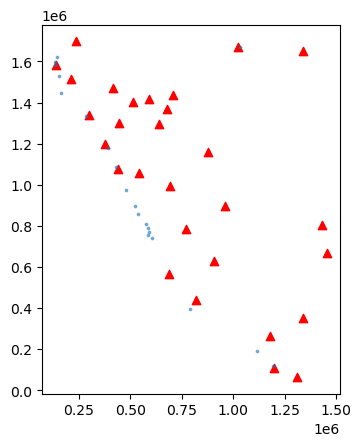

In [6]:
# realizamos un subconjunto de los aeropuertos medianos, ya que si hacemos de los largos, al ser solo 2, sería un problema
mediumAirports = airports[airports.kind=='medium_airport']
mediumAirports.reset_index(drop=True, inplace=True)

# observamos mediante un "plot" lo que nos resulta del crs 24891 proyectado
base = mediumAirports.plot(color='red',marker="^")
aeropuertosMaritimos_peru_24891.plot(ax=base,alpha=0.5,markersize=3)

In [7]:
# mediante el codigo .head(), observamos cuales son los principales (los primeros que nos da la data del csv)
aeropuertosMaritimos_peru_24891.head()

,nombreDelPuerto,Country Code,Latitude,Longitude,geometry
0,La Pampilla Oil Terminal,Peru,-11.933333,-77.133333,POINT (589113.575 768847.884)
1,Iquitos,Peru,-3.750000,-73.233333,POINT (1031485.913 1672619.329)
2,Chancay,Peru,-11.583333,-77.250000,POINT (576836.026 807768.749)
3,Puerto Supe,Peru,-10.800000,-77.750000,POINT (523049.750 895072.078)
4,Salaverry,Peru,-8.233333,-78.983333,POINT (389344.884 1179950.206)


In [8]:
# hacemos el mismo procedimiento con los aeropuertos medianos
mediumAirports.head()

,name,kind,latitude_deg,longitude_deg,elevation_ft,region_name,municipality,geometry
0,Rodríguez Ballón International Airport,medium_airport,-16.341101,-71.583099,8405.0,Arequipa Region,Arequipa,POINT (1178157.179 262424.347)
1,Inca Manco Capac International Airport,medium_airport,-15.467100,-70.158203,12552.0,Puno Region,Juliaca,POINT (1337130.244 353130.873)
2,Maria Reiche Neuman Airport,medium_airport,-14.854000,-74.961502,1860.0,Ica Region,Nazca,POINT (819040.718 440591.578)
3,Coronel FAP Francisco Secada Vignetta Internat...,medium_airport,-3.784740,-73.308800,306.0,Loreto Region,Iquitos,POINT (1023005.081 1668818.071)
4,Capitan FAP Carlos Martinez De Pinillos Intern...,medium_airport,-8.081410,-79.108803,106.0,La Libertad Region,Trujillo,POINT (375576.403 1196804.728)


In [9]:
# distancia entre 'Rodríguez Ballón International Airport' y "La Pampilla Oil Terminal" en km:
mediumAirports.iloc[0].geometry.distance(aeropuertosMaritimos_peru_24891.iloc[0].geometry)/1000

776.8121817046581

In [10]:
# intento N°1: en este caso, tendremos las distancias entre aeropuertos, sin embargo, solo tendremos el número de la fila 
# que lo representa, más no su nombre, lo cual no es recomendable
aeropuertosMaritimos_peru_24891.geometry.apply\
(lambda g: mediumAirports.geometry.distance(g)/1000)

,0,1,2,3,4,5,6,7,8,9,...,19,20,21,22,23,24,25,26,27,28
0,776.812182,855.774251,400.772620,999.103687,478.273128,641.822553,1007.866309,837.267330,551.269474,484.502415,...,392.394039,1156.672520,343.780886,678.673049,639.633211,182.076149,529.743958,224.023894,842.367355,649.731469
1,1417.801942,1354.425429,1250.210118,9.293765,810.318962,806.698743,1632.693399,837.109067,694.981495,536.335909,...,779.710118,306.708379,838.839447,400.286269,582.179483,927.284750,543.761644,1158.914056,954.501518,507.515842
2,811.780541,885.857154,439.866102,969.779749,438.011904,601.623007,1044.045473,797.039879,510.493052,461.577927,...,393.499473,1135.462495,303.453804,642.778454,599.599848,195.425372,492.410070,264.503068,853.845425,610.995072
3,910.718889,977.971022,542.368120,921.215607,335.843684,499.362192,1144.223860,694.811026,413.261182,440.857936,...,437.229266,1111.035713,201.436369,572.621823,509.154135,271.882209,417.594559,366.429120,912.028031,528.038627
4,1209.991132,1257.746913,855.154775,800.323082,21.763409,185.104164,1446.437982,380.368960,132.752392,487.012638,...,637.570993,1058.581335,113.291381,409.328603,256.970912,550.588333,275.447990,681.088767,1106.576867,313.149906
5,749.134422,830.853570,371.309131,1016.665803,507.915322,671.473948,979.534183,866.916560,580.162497,497.794395,...,388.496016,1167.654789,373.408832,702.062283,667.231941,172.032180,554.569670,194.415114,829.728482,675.850050
6,412.233587,550.284994,52.883659,1292.909003,899.869783,1063.471927,618.341252,1258.896706,966.812438,766.992893,...,527.544311,1368.388830,765.307846,1042.854058,1043.375127,385.861177,911.262423,198.233459,760.868317,1039.972381
7,997.500081,1059.347849,632.199667,883.896198,246.202754,409.579652,1231.905554,605.033032,329.567600,439.402876,...,488.328134,1094.599702,112.249880,517.915146,432.807574,348.990443,361.186435,456.214680,967.241427,460.022632
8,1112.943274,1166.568954,753.734501,832.156334,123.376004,286.928185,1348.641271,482.361574,215.562561,452.656039,...,563.812030,1069.606158,12.572162,448.355376,329.733251,456.417139,297.164477,578.898218,1039.833758,370.537792
9,1395.869937,1439.230104,1041.809256,810.091744,165.333214,12.688132,1632.660081,195.200582,163.117087,616.609215,...,805.466877,1098.905930,299.645071,435.109334,240.186495,735.512889,356.290255,866.580094,1262.208534,318.411235


In [11]:
# intento N°2: en este caso, pasa todo lo contrario al anterior, puesto que sabemos las distancias entre los dos aeropuertos
# sin embargo, como podemos ver, los aeropuertos medianos no están ordenados y resulta un poco confuso
aeropuertosMaritimos_peru_24891.set_index('nombreDelPuerto').geometry.apply\
(lambda g: mediumAirports.set_index('name').geometry.distance(g)/1000)

name,Rodríguez Ballón International Airport,Inca Manco Capac International Airport,Maria Reiche Neuman Airport,Coronel FAP Francisco Secada Vignetta International Airport,Capitan FAP Carlos Martinez De Pinillos International Airport,Air Force Captain Jose A Quinones Gonzales International Airport,Coronel FAP Carlos Ciriani Santa Rosa International Airport,Capitán FAP Guillermo Concha Iberico International Airport,Mayor General FAP Armando Revoredo Iglesias Airport,Cap FAP David Abenzur Rengifo International Airport,...,Teniente General Gerardo Pérez Pinedo Airport,Caballococha Airport,FAP Lieutenant Jaime Andres de Montreuil Morales Airport,Moises Benzaquen Rengifo Airport,Chachapoyas Airport,Francisco Carle Airport,Juanjui Airport,Captain Renán Elías Olivera International Airport,Iberia Airport,Juan Simons Vela Airport
nombreDelPuerto,,,,,,,,,,,,,,,,,,,,,
La Pampilla Oil Terminal,776.812182,855.774251,400.772620,999.103687,478.273128,641.822553,1007.866309,837.267330,551.269474,484.502415,...,392.394039,1156.672520,343.780886,678.673049,639.633211,182.076149,529.743958,224.023894,842.367355,649.731469
Iquitos,1417.801942,1354.425429,1250.210118,9.293765,810.318962,806.698743,1632.693399,837.109067,694.981495,536.335909,...,779.710118,306.708379,838.839447,400.286269,582.179483,927.284750,543.761644,1158.914056,954.501518,507.515842
Chancay,811.780541,885.857154,439.866102,969.779749,438.011904,601.623007,1044.045473,797.039879,510.493052,461.577927,...,393.499473,1135.462495,303.453804,642.778454,599.599848,195.425372,492.410070,264.503068,853.845425,610.995072
Puerto Supe,910.718889,977.971022,542.368120,921.215607,335.843684,499.362192,1144.223860,694.811026,413.261182,440.857936,...,437.229266,1111.035713,201.436369,572.621823,509.154135,271.882209,417.594559,366.429120,912.028031,528.038627
Salaverry,1209.991132,1257.746913,855.154775,800.323082,21.763409,185.104164,1446.437982,380.368960,132.752392,487.012638,...,637.570993,1058.581335,113.291381,409.328603,256.970912,550.588333,275.447990,681.088767,1106.576867,313.149906
Conchan Oil Terminal,749.134422,830.853570,371.309131,1016.665803,507.915322,671.473948,979.534183,866.916560,580.162497,497.794395,...,388.496016,1167.654789,373.408832,702.062283,667.231941,172.032180,554.569670,194.415114,829.728482,675.850050
Bahia San Nicolas,412.233587,550.284994,52.883659,1292.909003,899.869783,1063.471927,618.341252,1258.896706,966.812438,766.992893,...,527.544311,1368.388830,765.307846,1042.854058,1043.375127,385.861177,911.262423,198.233459,760.868317,1039.972381
Punta Lobitos (Bahia De Huarmey),997.500081,1059.347849,632.199667,883.896198,246.202754,409.579652,1231.905554,605.033032,329.567600,439.402876,...,488.328134,1094.599702,112.249880,517.915146,432.807574,348.990443,361.186435,456.214680,967.241427,460.022632
Puerto De Chimbote,1112.943274,1166.568954,753.734501,832.156334,123.376004,286.928185,1348.641271,482.361574,215.562561,452.656039,...,563.812030,1069.606158,12.572162,448.355376,329.733251,456.417139,297.164477,578.898218,1039.833758,370.537792


In [12]:
# intento N°3: caso contario con el intento N°2, en este caso, los eropuertos sí están ordenados por orden alfabético
# lo cual ayuda a una mejor ubicación
aeropuertosMaritimos_peru_24891.set_index('nombreDelPuerto').geometry.apply\
(lambda g: mediumAirports.set_index('name').geometry.distance(g)/1000).\
sort_index(axis=0).sort_index(axis=1)

name,Air Force Captain Jose A Quinones Gonzales International Airport,Air Force Colonel Alfredo Mendivil Duarte Airport,Alferez Fap David Figueroa Fernandini Airport,Caballococha Airport,Cadete FAP Guillermo Del Castillo Paredes Airport,Cap FAP David Abenzur Rengifo International Airport,Capitan FAP Carlos Martinez De Pinillos International Airport,Capitán FAP Guillermo Concha Iberico International Airport,Captain Pedro Canga Rodríguez International Airport,Captain Renán Elías Olivera International Airport,...,Inca Manco Capac International Airport,Juan Simons Vela Airport,Juanjui Airport,Maria Reiche Neuman Airport,Mayor General FAP Armando Revoredo Iglesias Airport,Moises Benzaquen Rengifo Airport,Padre Aldamiz International Airport,Rodríguez Ballón International Airport,Shumba Airport,Teniente General Gerardo Pérez Pinedo Airport
nombreDelPuerto,,,,,,,,,,,,,,,,,,,,,
Bahia De Ancon,621.329414,360.407383,233.468926,1144.637143,587.624155,471.447513,457.736134,816.757733,973.153039,244.694172,...,870.362226,629.403685,510.000955,420.516658,530.241168,659.582083,878.299104,794.139064,703.720152,391.275805
Bahia De Matarani,1411.977768,484.685201,908.811255,1476.006795,1256.750045,997.705578,1249.573107,1605.285461,1745.745215,572.279973,...,272.809080,1334.971091,1204.052367,388.854097,1297.688222,1311.354099,584.387951,93.468502,1461.424664,722.166777
Bahia San Nicolas,1063.471927,258.251810,605.425788,1368.388830,977.928996,766.992893,899.869783,1258.896706,1413.278364,198.233459,...,550.284994,1039.972381,911.262423,52.883659,966.812438,1042.854058,718.704444,412.233587,1138.260488,527.544311
Caleta Lobitos,304.601079,1239.749259,822.023449,1203.239692,590.128097,861.043074,468.103074,111.599115,141.034177,1169.429051,...,1730.725921,490.987590,587.480240,1344.743909,429.152144,594.876058,1613.259376,1694.914619,305.590826,1083.463929
Chancay,601.623007,375.286582,220.930167,1135.462495,570.553127,461.577927,438.011904,797.039879,953.306779,264.503068,...,885.857154,610.995072,492.410070,439.866102,510.493052,642.778454,888.004054,811.780541,684.019095,393.499473
Conchan Oil Terminal,671.473948,323.870006,268.135952,1167.654789,630.839539,497.794395,507.915322,866.916560,1023.441230,194.415114,...,830.853570,675.850050,554.569670,371.309131,580.162497,702.062283,853.807215,749.134422,753.489693,388.496016
Iquitos,806.698743,1052.732775,756.910190,306.708379,465.147146,536.335909,810.318962,837.109067,796.426425,1158.914056,...,1354.425429,507.515842,543.761644,1250.210118,694.981495,400.286269,1088.791036,1417.801942,649.761818,779.710118
La Pampilla Oil Terminal,641.822553,346.964370,249.402520,1156.672520,606.945062,484.502415,478.273128,837.267330,994.046215,224.023894,...,855.774251,649.731469,529.743958,400.772620,551.269474,678.673049,870.567236,776.812182,724.750648,392.394039
Paita,236.337903,1173.729073,758.796100,1189.847255,548.806863,810.958536,398.994174,57.086742,187.949495,1099.042808,...,1667.832656,451.839445,537.914317,1275.172980,369.123444,561.480124,1558.451136,1628.554249,265.682567,1024.778968


In [13]:
distanciaMatrixKilometros_mar_aire = aeropuertosMaritimos_peru_24891.set_index('nombreDelPuerto').geometry.apply\
                                    (lambda g: mediumAirports.set_index('name').geometry.distance(g)/1000).\
                                     sort_index(axis=0).sort_index(axis=1)

In [14]:
# la distancia media desde un puerto marítimo a todos los aeropuertos medianos (ordenados) obtenidos en el intento N°3
distanciaMatrixKilometros_mar_aire.mean(axis=1).sort_values(ascending=True)

nombreDelPuerto
Puerto De Chimbote                   597.575053
Punta Lobitos (Bahia De Huarmey)     603.511515
Salaverry                            609.118065
Puerto Supe                          612.271055
Puerto De Huacho                     620.197922
Chancay                              628.279839
Bahia De Ancon                       633.795538
La Pampilla Oil Terminal             640.842282
Puerto Del Callao                    646.915003
Conchan Oil Terminal                 648.243786
Pimental                             684.643679
Puerto Bayovar                       801.901272
Bahia San Nicolas                    813.601512
Paita                                838.908686
Iquitos                              841.935480
Talara                               878.266033
Caleta Lobitos                       886.592825
Puerto Cabo Blanco                   895.836111
Bahia De Matarani                    992.835809
Puerto Ilo                          1068.677164
dtype: float64

In [15]:
algunasEstadisticas = pd.DataFrame()
algunasEstadisticas['mean'] = distanciaMatrixKilometros_mar_aire.mean(axis=1)
algunasEstadisticas['min'] = distanciaMatrixKilometros_mar_aire.min(axis=1)
algunasEstadisticas['max'] = distanciaMatrixKilometros_mar_aire.max(axis=1)

# observamos el encabezado de "algunasEstadisticas":
algunasEstadisticas.head()

,mean,min,max
nombreDelPuerto,,,
Bahia De Ancon,633.795538,186.866835,1144.637143
Bahia De Matarani,992.835809,93.468502,1745.745215
Bahia San Nicolas,813.601512,52.883659,1413.278364
Caleta Lobitos,886.592825,14.373929,1932.301941
Chancay,628.279839,195.425372,1135.462495


In [16]:
# aeropuertos más alejados a cada puerto marítimo
distanciaMatrixKilometros_mar_aire.idxmax(axis="columns")

nombreDelPuerto
Bahia De Ancon                                                   Caballococha Airport
Bahia De Matarani                   Captain Pedro Canga Rodríguez International Ai...
Bahia San Nicolas                   Captain Pedro Canga Rodríguez International Ai...
Caleta Lobitos                      Coronel FAP Carlos Ciriani Santa Rosa Internat...
Chancay                                                          Caballococha Airport
Conchan Oil Terminal                                             Caballococha Airport
Iquitos                             Coronel FAP Carlos Ciriani Santa Rosa Internat...
La Pampilla Oil Terminal                                         Caballococha Airport
Paita                               Coronel FAP Carlos Ciriani Santa Rosa Internat...
Pimental                            Coronel FAP Carlos Ciriani Santa Rosa Internat...
Puerto Bayovar                      Coronel FAP Carlos Ciriani Santa Rosa Internat...
Puerto Cabo Blanco                  Co

In [17]:
# puerto marítimo más lejano a cada aeropuerto
distanciaMatrixKilometros_mar_aire.idxmax(axis="rows")

name
Air Force Captain Jose A Quinones Gonzales International Airport            Puerto Ilo
Air Force Colonel Alfredo Mendivil Duarte Airport                   Puerto Cabo Blanco
Alferez Fap David Figueroa Fernandini Airport                               Puerto Ilo
Caballococha Airport                                                        Puerto Ilo
Cadete FAP Guillermo Del Castillo Paredes Airport                           Puerto Ilo
Cap FAP David Abenzur Rengifo International Airport                         Puerto Ilo
Capitan FAP Carlos Martinez De Pinillos International Airport               Puerto Ilo
Capitán FAP Guillermo Concha Iberico International Airport                  Puerto Ilo
Captain Pedro Canga Rodríguez International Airport                         Puerto Ilo
Captain Renán Elías Olivera International Airport                   Puerto Cabo Blanco
Captain Victor Montes Arias International Airport                           Puerto Ilo
Chachapoyas Airport                   

In [18]:
# aeropuerto más cercano a cada puerto marítimo
distanciaMatrixKilometros_mar_aire.idxmin(axis="columns")

nombreDelPuerto
Bahia De Ancon                                                Francisco Carle Airport
Bahia De Matarani                              Rodríguez Ballón International Airport
Bahia San Nicolas                                         Maria Reiche Neuman Airport
Caleta Lobitos                      Captain Victor Montes Arias International Airport
Chancay                                                       Francisco Carle Airport
Conchan Oil Terminal                                          Francisco Carle Airport
Iquitos                             Coronel FAP Francisco Secada Vignetta Internat...
La Pampilla Oil Terminal                                      Francisco Carle Airport
Paita                               Capitán FAP Guillermo Concha Iberico Internati...
Pimental                            Air Force Captain Jose A Quinones Gonzales Int...
Puerto Bayovar                      Capitán FAP Guillermo Concha Iberico Internati...
Puerto Cabo Blanco                  Ca

In [19]:
# puerto marítimo más cercano a cada aeropuerto
distanciaMatrixKilometros_mar_aire.idxmin(axis="rows")

name
Air Force Captain Jose A Quinones Gonzales International Airport                            Pimental
Air Force Colonel Alfredo Mendivil Duarte Airport                                  Bahia San Nicolas
Alferez Fap David Figueroa Fernandini Airport                                            Puerto Supe
Caballococha Airport                                                                         Iquitos
Cadete FAP Guillermo Del Castillo Paredes Airport                                          Salaverry
Cap FAP David Abenzur Rengifo International Airport                 Punta Lobitos (Bahia De Huarmey)
Capitan FAP Carlos Martinez De Pinillos International Airport                              Salaverry
Capitán FAP Guillermo Concha Iberico International Airport                                     Paita
Captain Pedro Canga Rodríguez International Airport                               Puerto Cabo Blanco
Captain Renán Elías Olivera International Airport                               Concha

In [77]:
# EJERCICIO N°2:

In [21]:
# ahora analizaremos las distancias del layer "areasUrbanasNacionales"
areasUrbanasNacionales

,objectid_1,anp_gid,anp_codi,anp_cate,anp_nomb,anp_sect,anp_ubpo,anp_suleg,anp_uicn,anp_balec,anp_felec,anp_balem,anp_felem,anp_obs,met_link,anp_orden,anp_id,geometry
0,17163,1,BP01,Bosque de Protección,Aledaño a la Bocatoma del Canal Nuevo Imperial,NaN,Lima,18.11,VI - Uso sostenible de recursos naturales,R.S. N° 0007-1980-AA/DGFF,1980-05-19,NaN,NaN,NaN,NaN,85,85,"POLYGON ((-76.21944 -13.04386, -76.21934 -13.0..."
1,17219,57,RN13.09,Reserva Nacional,"Sistema de Islas, Islotes y Puntas Guaneras - ...",NaN,Ancash,2953.89,VI - Uso sostenible de recursos naturales,D.S. N° 024-2009-MINAM,2009-12-31,NaN,NaN,NaN,NaN,53,53,"POLYGON ((-78.22908 -9.94976, -78.22902 -9.949..."
2,17164,2,BP02,Bosque de Protección,Puquio Santa Rosa,NaN,La Libertad,72.50,VI - Uso sostenible de recursos naturales,R.S. N° 0434-1982-AG/DGFF,1982-09-02,NaN,NaN,NaN,NaN,86,86,"POLYGON ((-78.72574 -8.60734, -78.72574 -8.607..."
3,17165,3,BP03,Bosque de Protección,de Pui Pui,NaN,Junín,60000.00,VI - Uso sostenible de recursos naturales,R.S. N° 0042-1985-AG/DGFF,1985-01-31,NaN,NaN,NaN,NaN,87,87,"POLYGON ((-74.89181 -11.26586, -74.89166 -11.2..."
4,17193,27,RC03,Reserva Comunal,Amarakaeri,NaN,Madre de Dios,402335.62,VI - Uso sostenible de recursos naturales,D.S. N° 031-2002-AG,2002-05-09,NaN,NaN,NaN,NaN,75,75,"POLYGON ((-71.08318 -12.58558, -71.08371 -12.5..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,17494,7,CC01,Coto de Caza,El Angolo,NaN,Piura,65000.00,VI - Uso sostenible de recursos naturales,R.S. N° 0264-1975-AG,1975-07-01,NaN,NaN,NaN,NaN,83,83,"POLYGON ((-80.94697 -4.40025, -80.94737 -4.400..."
94,17313,25,RC01,Reserva Comunal,Yanesha,NaN,Pasco,34744.70,VI - Uso sostenible de recursos naturales,R.S. N° 0193-1988-AG-DGFF,1988-04-28,NaN,NaN,Precisión de la Base Grafica Digital del ANP R...,NaN,73,73,"POLYGON ((-75.35482 -10.16365, -75.30743 -10.1..."
95,17434,345,RN16,Reserva Nacional,Dorsal de Nasca,NaN,NaN,6239205.75,VI - Uso sostenible de recursos naturales,D.S. Nº 008-2021-MINAM,2021-06-05,NaN,NaN,La superficie aprobado en el D.S. Nº 008-2021-...,NaN,91,91,"POLYGON ((-76.99982 -17.58209, -77.67432 -17.7..."
96,17507,4,BP04,Bosque de Protección,San Matias-San Carlos,NaN,Pasco,145818.00,VI - Uso sostenible de recursos naturales,R.S. N° 0101-1987-AG/DGFF,1987-03-20,NaN,NaN,NaN,NaN,88,88,"POLYGON ((-75.13236 -10.47496, -75.13139 -10.4..."


In [37]:
areasUrbanasNacionalesRenombrada = areasUrbanasNacionales.rename(columns = {'anp_nomb': 'areaNacional'})

In [38]:
# vemos "areasUrbanasNacionalesRenombrada", ya con la columna renombrada
areasUrbanasNacionalesRenombrada

,objectid_1,anp_gid,anp_codi,anp_cate,areaNacional,anp_sect,anp_ubpo,anp_suleg,anp_uicn,anp_balec,anp_felec,anp_balem,anp_felem,anp_obs,met_link,anp_orden,anp_id,geometry
0,17163,1,BP01,Bosque de Protección,Aledaño a la Bocatoma del Canal Nuevo Imperial,NaN,Lima,18.11,VI - Uso sostenible de recursos naturales,R.S. N° 0007-1980-AA/DGFF,1980-05-19,NaN,NaN,NaN,NaN,85,85,"POLYGON ((-76.21944 -13.04386, -76.21934 -13.0..."
1,17219,57,RN13.09,Reserva Nacional,"Sistema de Islas, Islotes y Puntas Guaneras - ...",NaN,Ancash,2953.89,VI - Uso sostenible de recursos naturales,D.S. N° 024-2009-MINAM,2009-12-31,NaN,NaN,NaN,NaN,53,53,"POLYGON ((-78.22908 -9.94976, -78.22902 -9.949..."
2,17164,2,BP02,Bosque de Protección,Puquio Santa Rosa,NaN,La Libertad,72.50,VI - Uso sostenible de recursos naturales,R.S. N° 0434-1982-AG/DGFF,1982-09-02,NaN,NaN,NaN,NaN,86,86,"POLYGON ((-78.72574 -8.60734, -78.72574 -8.607..."
3,17165,3,BP03,Bosque de Protección,de Pui Pui,NaN,Junín,60000.00,VI - Uso sostenible de recursos naturales,R.S. N° 0042-1985-AG/DGFF,1985-01-31,NaN,NaN,NaN,NaN,87,87,"POLYGON ((-74.89181 -11.26586, -74.89166 -11.2..."
4,17193,27,RC03,Reserva Comunal,Amarakaeri,NaN,Madre de Dios,402335.62,VI - Uso sostenible de recursos naturales,D.S. N° 031-2002-AG,2002-05-09,NaN,NaN,NaN,NaN,75,75,"POLYGON ((-71.08318 -12.58558, -71.08371 -12.5..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,17494,7,CC01,Coto de Caza,El Angolo,NaN,Piura,65000.00,VI - Uso sostenible de recursos naturales,R.S. N° 0264-1975-AG,1975-07-01,NaN,NaN,NaN,NaN,83,83,"POLYGON ((-80.94697 -4.40025, -80.94737 -4.400..."
94,17313,25,RC01,Reserva Comunal,Yanesha,NaN,Pasco,34744.70,VI - Uso sostenible de recursos naturales,R.S. N° 0193-1988-AG-DGFF,1988-04-28,NaN,NaN,Precisión de la Base Grafica Digital del ANP R...,NaN,73,73,"POLYGON ((-75.35482 -10.16365, -75.30743 -10.1..."
95,17434,345,RN16,Reserva Nacional,Dorsal de Nasca,NaN,NaN,6239205.75,VI - Uso sostenible de recursos naturales,D.S. Nº 008-2021-MINAM,2021-06-05,NaN,NaN,La superficie aprobado en el D.S. Nº 008-2021-...,NaN,91,91,"POLYGON ((-76.99982 -17.58209, -77.67432 -17.7..."
96,17507,4,BP04,Bosque de Protección,San Matias-San Carlos,NaN,Pasco,145818.00,VI - Uso sostenible de recursos naturales,R.S. N° 0101-1987-AG/DGFF,1987-03-20,NaN,NaN,NaN,NaN,88,88,"POLYGON ((-75.13236 -10.47496, -75.13139 -10.4..."


In [40]:
# nos quedamos con uno de ellos
areasUrbanasNacionalesRenombrada[areasUrbanasNacionalesRenombrada.areaNacional.str.contains('Yanesha')]

,objectid_1,anp_gid,anp_codi,anp_cate,areaNacional,anp_sect,anp_ubpo,anp_suleg,anp_uicn,anp_balec,anp_felec,anp_balem,anp_felem,anp_obs,met_link,anp_orden,anp_id,geometry
94,17313,25,RC01,Reserva Comunal,Yanesha,NaN,Pasco,34744.7,VI - Uso sostenible de recursos naturales,R.S. N° 0193-1988-AG-DGFF,1988-04-28,NaN,NaN,Precisión de la Base Grafica Digital del ANP R...,NaN,73,73,"POLYGON ((-75.35482 -10.16365, -75.30743 -10.1..."


In [41]:
# calculamos la distancia entre las áreas urbanas nacionales y el aeropuerto
areasUrbanasNacionalesRenombrada[areasUrbanasNacionalesRenombrada.areaNacional.str.contains('Yanesha')].iloc[0].geometry.distance(mediumAirports.geometry)

0     1.207105e+06
1     1.383050e+06
2     9.300972e+05
3     1.957468e+06
4     1.254384e+06
5     1.372529e+06
6     1.310878e+06
7     1.529448e+06
8     1.374607e+06
9     1.453087e+06
10    1.600607e+06
11    1.528273e+06
12    1.590612e+06
13    1.714126e+06
14    1.186371e+06
15    1.102044e+06
16    1.213213e+06
17    1.201936e+06
18    1.528992e+06
19    1.313550e+06
20    2.124673e+06
21    1.164495e+06
22    1.601972e+06
23    1.495625e+06
24    1.098535e+06
25    1.445241e+06
26    8.893422e+05
27    1.641971e+06
28    1.537233e+06
Name: geometry, dtype: float64

In [42]:
distance_areUrbNac_aire = areasUrbanasNacionalesRenombrada.set_index('areaNacional').geometry.apply\
(lambda g: mediumAirports.set_index('name').geometry.distance(g)/1000).\
sort_index(axis=0).sort_index(axis=1)

# mostramos dichas distancias obtenidas
distance_areUrbNac_aire

name,Air Force Captain Jose A Quinones Gonzales International Airport,Air Force Colonel Alfredo Mendivil Duarte Airport,Alferez Fap David Figueroa Fernandini Airport,Caballococha Airport,Cadete FAP Guillermo Del Castillo Paredes Airport,Cap FAP David Abenzur Rengifo International Airport,Capitan FAP Carlos Martinez De Pinillos International Airport,Capitán FAP Guillermo Concha Iberico International Airport,Captain Pedro Canga Rodríguez International Airport,Captain Renán Elías Olivera International Airport,...,Inca Manco Capac International Airport,Juan Simons Vela Airport,Juanjui Airport,Maria Reiche Neuman Airport,Mayor General FAP Armando Revoredo Iglesias Airport,Moises Benzaquen Rengifo Airport,Padre Aldamiz International Airport,Rodríguez Ballón International Airport,Shumba Airport,Teniente General Gerardo Pérez Pinedo Airport
areaNacional,,,,,,,,,,,,,,,,,,,,,
Airo Pai,1372.519909,1102.037811,1213.204408,2124.664990,1528.264343,1453.079092,1254.374979,1529.438109,1714.116159,889.335583,...,1383.046781,1537.223782,1445.232057,930.092066,1374.597894,1601.963005,1600.602135,1207.102635,1528.982893,1313.542467
Aledaño a la Bocatoma del Canal Nuevo Imperial,1372.532438,1102.046275,1213.215565,2124.675700,1528.276235,1453.090018,1254.387364,1529.450688,1714.128738,889.344800,...,1383.051603,1537.235915,1445.243958,930.099446,1374.610220,1601.974907,1600.608873,1207.107002,1528.995339,1313.552175
Allpahuayo Mishana,1372.522821,1102.038732,1213.206399,2124.666774,1528.266727,1453.080974,1254.377721,1529.441160,1714.119209,889.336773,...,1383.046544,1537.226322,1445.234447,930.092622,1374.600583,1601.965395,1600.602486,1207.102265,1528.985697,1313.543842
Alto Mayo,1372.525274,1102.043033,1213.210085,2124.670628,1528.270003,1453.084752,1254.380486,1529.443305,1714.121356,889.340977,...,1383.050796,1537.229395,1445.237715,930.097004,1374.603435,1601.968663,1600.606879,1207.106465,1528.988355,1313.547959
Alto Purús,1372.528286,1102.039955,1213.209890,2124.669833,1528.271047,1453.084237,1254.382813,1529.446937,1714.124984,889.338563,...,1383.045418,1537.230977,1445.238779,930.093086,1374.605559,1601.969730,1600.602525,1207.100880,1528.990924,1313.546025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
del Titicaca,1372.533240,1102.042277,1213.213736,2124.673404,1528.275393,1453.087940,1254.387582,1529.452029,1714.130075,889.341283,...,1383.045969,1537.235512,1445.243133,930.094857,1374.610268,1601.974084,1600.603981,1207.101224,1528.995762,1313.549015
del Titicaca,1372.533214,1102.042265,1213.213715,2124.673384,1528.275369,1453.087919,1254.387557,1529.452003,1714.130049,889.341268,...,1383.045968,1537.235488,1445.243109,930.094848,1374.610243,1601.974060,1600.603974,1207.101223,1528.995737,1313.548998
del Titicaca,1372.533593,1102.042542,1213.214064,2124.673722,1528.275737,1453.088263,1254.387934,1529.452381,1714.130428,889.341566,...,1383.046121,1537.235861,1445.243477,930.095094,1374.610619,1601.974428,1600.604199,1207.101359,1528.996115,1313.549310


In [43]:
# vemos las distancias de "Aledaño a la Bocatoma del Canal Nuevo Imperial" con los aeropuertos medianos
distance_areUrbNac_aire.loc['Aledaño a la Bocatoma del Canal Nuevo Imperial'].sort_values()

name
Captain Renán Elías Olivera International Airport                    889.344800
Maria Reiche Neuman Airport                                          930.099446
Francisco Carle Airport                                             1098.537239
Air Force Colonel Alfredo Mendivil Duarte Airport                   1102.046275
FAP Lieutenant Jaime Andres de Montreuil Morales Airport            1164.497550
Comandante FAP German Arias Graziani Airport                        1186.374404
General Jorge Fernandez Maldon Airport                              1201.937698
Rodríguez Ballón International Airport                              1207.107002
Alferez Fap David Figueroa Fernandini Airport                       1213.215565
Capitan FAP Carlos Martinez De Pinillos International Airport       1254.387364
Coronel FAP Carlos Ciriani Santa Rosa International Airport         1310.878815
Teniente General Gerardo Pérez Pinedo Airport                       1313.552175
Air Force Captain Jose A Quinones G

In [44]:
base = areasUrbanasNacionalesRenombrada[areasUrbanasNacionalesRenombrada.areaNacional.str.contains('Aledaño a la Bocatoma del Canal Nuevo Imperial')].explore()
mediumAirports.explore(m=base,color='red',marker_kwds=dict(radius=10))

In [45]:
areasUrbanasNacionalesRenombrada[~areasUrbanasNacionalesRenombrada.areaNacional.isna()]

,objectid_1,anp_gid,anp_codi,anp_cate,areaNacional,anp_sect,anp_ubpo,anp_suleg,anp_uicn,anp_balec,anp_felec,anp_balem,anp_felem,anp_obs,met_link,anp_orden,anp_id,geometry
0,17163,1,BP01,Bosque de Protección,Aledaño a la Bocatoma del Canal Nuevo Imperial,NaN,Lima,18.11,VI - Uso sostenible de recursos naturales,R.S. N° 0007-1980-AA/DGFF,1980-05-19,NaN,NaN,NaN,NaN,85,85,"POLYGON ((-76.21944 -13.04386, -76.21934 -13.0..."
1,17219,57,RN13.09,Reserva Nacional,"Sistema de Islas, Islotes y Puntas Guaneras - ...",NaN,Ancash,2953.89,VI - Uso sostenible de recursos naturales,D.S. N° 024-2009-MINAM,2009-12-31,NaN,NaN,NaN,NaN,53,53,"POLYGON ((-78.22908 -9.94976, -78.22902 -9.949..."
2,17164,2,BP02,Bosque de Protección,Puquio Santa Rosa,NaN,La Libertad,72.50,VI - Uso sostenible de recursos naturales,R.S. N° 0434-1982-AG/DGFF,1982-09-02,NaN,NaN,NaN,NaN,86,86,"POLYGON ((-78.72574 -8.60734, -78.72574 -8.607..."
3,17165,3,BP03,Bosque de Protección,de Pui Pui,NaN,Junín,60000.00,VI - Uso sostenible de recursos naturales,R.S. N° 0042-1985-AG/DGFF,1985-01-31,NaN,NaN,NaN,NaN,87,87,"POLYGON ((-74.89181 -11.26586, -74.89166 -11.2..."
4,17193,27,RC03,Reserva Comunal,Amarakaeri,NaN,Madre de Dios,402335.62,VI - Uso sostenible de recursos naturales,D.S. N° 031-2002-AG,2002-05-09,NaN,NaN,NaN,NaN,75,75,"POLYGON ((-71.08318 -12.58558, -71.08371 -12.5..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,17494,7,CC01,Coto de Caza,El Angolo,NaN,Piura,65000.00,VI - Uso sostenible de recursos naturales,R.S. N° 0264-1975-AG,1975-07-01,NaN,NaN,NaN,NaN,83,83,"POLYGON ((-80.94697 -4.40025, -80.94737 -4.400..."
94,17313,25,RC01,Reserva Comunal,Yanesha,NaN,Pasco,34744.70,VI - Uso sostenible de recursos naturales,R.S. N° 0193-1988-AG-DGFF,1988-04-28,NaN,NaN,Precisión de la Base Grafica Digital del ANP R...,NaN,73,73,"POLYGON ((-75.35482 -10.16365, -75.30743 -10.1..."
95,17434,345,RN16,Reserva Nacional,Dorsal de Nasca,NaN,NaN,6239205.75,VI - Uso sostenible de recursos naturales,D.S. Nº 008-2021-MINAM,2021-06-05,NaN,NaN,La superficie aprobado en el D.S. Nº 008-2021-...,NaN,91,91,"POLYGON ((-76.99982 -17.58209, -77.67432 -17.7..."
96,17507,4,BP04,Bosque de Protección,San Matias-San Carlos,NaN,Pasco,145818.00,VI - Uso sostenible de recursos naturales,R.S. N° 0101-1987-AG/DGFF,1987-03-20,NaN,NaN,NaN,NaN,88,88,"POLYGON ((-75.13236 -10.47496, -75.13139 -10.4..."


In [46]:
tipoReserva = areasUrbanasNacionalesRenombrada.dissolve(by='anp_cate')
tipoReserva

,geometry,objectid_1,anp_gid,anp_codi,areaNacional,anp_sect,anp_ubpo,anp_suleg,anp_uicn,anp_balec,anp_felec,anp_balem,anp_felem,anp_obs,met_link,anp_orden,anp_id
anp_cate,,,,,,,,,,,,,,,,,
Bosque de Protección,"MULTIPOLYGON (((-76.21925 -13.04355, -76.21898...",17163,1,BP01,Aledaño a la Bocatoma del Canal Nuevo Imperial,None,Lima,18.11,VI - Uso sostenible de recursos naturales,R.S. N° 0007-1980-AA/DGFF,1980-05-19,None,None,None,NaN,85,85
Coto de Caza,"MULTIPOLYGON (((-78.44147 -7.25553, -78.44041 ...",17168,8,CC02,Sunchubamba,None,Cajamarca y la Libertad,59735.00,VI - Uso sostenible de recursos naturales,R.M. N° 00462-1977-AG,1977-04-22,None,None,None,NaN,84,84
Parque Nacional,"MULTIPOLYGON (((-77.30786 -9.88933, -77.33191 ...",17172,9,PN01,de Cutervo,Sector Norte,Cajamarca,2429.54,II - Protección de Ecosistemas y Recreación,LEY N° 13694,1961-09-08,LEY N° 28860,2006-08-03,Precisión de Limites,NaN,1,1
Refugio de Vida Silvestre,"MULTIPOLYGON (((-76.99243 -12.20104, -76.99208...",17231,82,RVS03,Bosques Nublados de Udima,Sector Sur,Cajamarca,9849.64,IV - Conservar el hábitat por intervención con...,D.S. N° 020-2011-MINAM,2011-07-21,None,None,None,NaN,31,31
Reserva Comunal,"MULTIPOLYGON (((-71.08392 -12.58439, -71.08231...",17193,27,RC03,Amarakaeri,None,Madre de Dios,402335.62,VI - Uso sostenible de recursos naturales,D.S. N° 031-2002-AG,2002-05-09,D.S. N° 021-2003-AG,2003-05-30,Precisión de la Base Grafica Digital del ANP R...,NaN,75,75
Reserva Nacional,"MULTIPOLYGON (((-77.64642 -11.29252, -77.64623...",17219,57,RN13.09,"Sistema de Islas, Islotes y Puntas Guaneras - ...",Sector Ramis,Ancash,2953.89,VI - Uso sostenible de recursos naturales,D.S. N° 024-2009-MINAM,2009-12-31,D.S. N° 017-1993-PCM,1993-04-06,Precisión de la base gráfica de la RN del Titi...,NaN,53,53
Reserva Paisajistica,"MULTIPOLYGON (((-72.47609 -14.76023, -72.47553...",17229,77,RP01,Nor Yauyos-Cochas,None,Lima y Junín,221268.48,V - Paisajes de conservación y Recreación,D.S. N° 033-2001-AG,2001-05-01,None,None,None,NaN,32,32
Santuario Histórico,"MULTIPOLYGON (((-72.50557 -13.09547, -72.50569...",17253,85,SH02,de la Pampa de Ayacucho,None,Ayacucho,300.00,III - Conservación de características naturale...,D.S. N° 119-1980-AA,1980-08-14,None,None,None,NaN,26,26
Santuario Nacional,"MULTIPOLYGON (((-71.83386 -17.16245, -71.83385...",17257,90,SN03,Lagunas de Mejía,None,Arequipa,690.60,III - Conservación de características naturale...,D.S. N° 015-1984-AG,1984-02-24,D.S. N° 017-2009-MINAM,2009-09-03,None,NaN,18,18


In [47]:
#eliminamos las columnas con las que no deseamos trabajar
tipoReserva = tipoReserva.iloc[:, [0, 4]].copy()

# mostramos como quedaría una variable "tipoReserva"
tipoReserva

,geometry,areaNacional
anp_cate,,
Bosque de Protección,"MULTIPOLYGON (((-76.21925 -13.04355, -76.21898...",Aledaño a la Bocatoma del Canal Nuevo Imperial
Coto de Caza,"MULTIPOLYGON (((-78.44147 -7.25553, -78.44041 ...",Sunchubamba
Parque Nacional,"MULTIPOLYGON (((-77.30786 -9.88933, -77.33191 ...",de Cutervo
Refugio de Vida Silvestre,"MULTIPOLYGON (((-76.99243 -12.20104, -76.99208...",Bosques Nublados de Udima
Reserva Comunal,"MULTIPOLYGON (((-71.08392 -12.58439, -71.08231...",Amarakaeri
Reserva Nacional,"MULTIPOLYGON (((-77.64642 -11.29252, -77.64623...","Sistema de Islas, Islotes y Puntas Guaneras - ..."
Reserva Paisajistica,"MULTIPOLYGON (((-72.47609 -14.76023, -72.47553...",Nor Yauyos-Cochas
Santuario Histórico,"MULTIPOLYGON (((-72.50557 -13.09547, -72.50569...",de la Pampa de Ayacucho
Santuario Nacional,"MULTIPOLYGON (((-71.83386 -17.16245, -71.83385...",Lagunas de Mejía


In [48]:
# formateamos el geoDataFrame
tipoReserva['areaNacional']=tipoReserva.index
tipoReserva.reset_index(drop=True,inplace=True)

# finalmente mostramos como queda nuestra variable "tipoReserva"
tipoReserva

,geometry,areaNacional
0,"MULTIPOLYGON (((-76.21925 -13.04355, -76.21898...",Bosque de Protección
1,"MULTIPOLYGON (((-78.44147 -7.25553, -78.44041 ...",Coto de Caza
2,"MULTIPOLYGON (((-77.30786 -9.88933, -77.33191 ...",Parque Nacional
3,"MULTIPOLYGON (((-76.99243 -12.20104, -76.99208...",Refugio de Vida Silvestre
4,"MULTIPOLYGON (((-71.08392 -12.58439, -71.08231...",Reserva Comunal
5,"MULTIPOLYGON (((-77.64642 -11.29252, -77.64623...",Reserva Nacional
6,"MULTIPOLYGON (((-72.47609 -14.76023, -72.47553...",Reserva Paisajistica
7,"MULTIPOLYGON (((-72.50557 -13.09547, -72.50569...",Santuario Histórico
8,"MULTIPOLYGON (((-71.83386 -17.16245, -71.83385...",Santuario Nacional


In [49]:
distance_areUrbNac_aire = tipoReserva.set_index('areaNacional').geometry.apply\
(lambda g: mediumAirports.set_index('name').geometry.distance(g)/1000).\
sort_index(axis=0).sort_index(axis=1)


# mostramos las distancias entre nuestro límite seleccionado con los aeropuertos medianos
distance_areUrbNac_aire

name,Air Force Captain Jose A Quinones Gonzales International Airport,Air Force Colonel Alfredo Mendivil Duarte Airport,Alferez Fap David Figueroa Fernandini Airport,Caballococha Airport,Cadete FAP Guillermo Del Castillo Paredes Airport,Cap FAP David Abenzur Rengifo International Airport,Capitan FAP Carlos Martinez De Pinillos International Airport,Capitán FAP Guillermo Concha Iberico International Airport,Captain Pedro Canga Rodríguez International Airport,Captain Renán Elías Olivera International Airport,...,Inca Manco Capac International Airport,Juan Simons Vela Airport,Juanjui Airport,Maria Reiche Neuman Airport,Mayor General FAP Armando Revoredo Iglesias Airport,Moises Benzaquen Rengifo Airport,Padre Aldamiz International Airport,Rodríguez Ballón International Airport,Shumba Airport,Teniente General Gerardo Pérez Pinedo Airport
areaNacional,,,,,,,,,,,,,,,,,,,,,
Bosque de Protección,1372.525274,1102.043033,1213.210085,2124.670628,1528.270003,1453.084752,1254.380486,1529.443305,1714.121356,889.340977,...,1383.049486,1537.229395,1445.237715,930.096912,1374.603435,1601.968663,1600.606436,1207.104966,1528.988355,1313.547959
Coto de Caza,1372.524762,1102.044784,1213.210866,2124.671641,1528.270297,1453.085657,1254.380261,1529.442528,1714.120581,889.342600,...,1383.052180,1537.229473,1445.238002,930.098626,1374.603293,1601.968948,1600.608421,1207.107811,1528.988030,1313.549402
Parque Nacional,1372.519655,1102.035803,1213.203860,2124.664128,1528.264258,1453.078376,1254.374784,1529.437789,1714.115839,889.333905,...,1383.043533,1537.223650,1445.231970,930.089646,1374.597716,1601.962917,1600.599495,1207.099261,1528.982677,1313.541029
Refugio de Vida Silvestre,1372.526526,1102.045010,1213.211862,2124.672477,1528.271610,1453.086568,1254.381875,1529.444422,1714.122474,889.342971,...,1383.052131,1537.230916,1445.239319,930.098934,1374.604862,1601.970266,1600.608782,1207.107569,1528.989697,1313.549922
Reserva Comunal,1372.519545,1102.037730,1213.204290,2124.664902,1528.264130,1453.078997,1254.374667,1529.437697,1714.115747,889.335500,...,1383.045387,1537.223527,1445.231842,930.091986,1374.597597,1601.962789,1600.602056,1207.100853,1528.982562,1313.542383
Reserva Nacional,1372.521454,1102.038732,1213.205985,2124.666545,1528.265939,1453.080658,1254.376559,1529.439578,1714.117628,889.336773,...,1383.044258,1537.225376,1445.233653,930.092622,1374.599480,1601.964601,1600.601895,1207.099605,1528.984466,1313.543842
Reserva Paisajistica,1372.531080,1102.044092,1213.214235,2124.674395,1528.274870,1453.088702,1254.385995,1529.449349,1714.127399,889.342938,...,1383.048289,1537.234544,1445.242594,930.096862,1374.608849,1601.973543,1600.606081,1207.103584,1528.993972,1313.550543
Santuario Histórico,1372.526758,1102.043215,1213.212168,2124.672792,1528.271891,1453.086878,1254.382125,1529.444633,1714.122685,889.341944,...,1383.047942,1537.231185,1445.239600,930.096148,1374.605117,1601.970547,1600.605460,1207.103300,1528.989941,1313.549477
Santuario Nacional,1372.523907,1102.042344,1213.209975,2124.670758,1528.269405,1453.084769,1254.379389,1529.441696,1714.119749,889.341015,...,1383.047293,1537.228587,1445.237110,930.095349,1374.602417,1601.968057,1600.604697,1207.102680,1528.987162,1313.548319


In [50]:
mins = distance_areUrbNac_aire.idxmin(axis="columns")
mins

areaNacional
Bosque de Protección         Captain Renán Elías Olivera International Airport
Coto de Caza                 Captain Renán Elías Olivera International Airport
Parque Nacional              Captain Renán Elías Olivera International Airport
Refugio de Vida Silvestre    Captain Renán Elías Olivera International Airport
Reserva Comunal              Captain Renán Elías Olivera International Airport
Reserva Nacional             Captain Renán Elías Olivera International Airport
Reserva Paisajistica         Captain Renán Elías Olivera International Airport
Santuario Histórico          Captain Renán Elías Olivera International Airport
Santuario Nacional           Captain Renán Elías Olivera International Airport
dtype: object

In [51]:
# uno de ellos
mins[1]

'Captain Renán Elías Olivera International Airport'

In [52]:
# recordamos que "mins" es "distance_areUrbNac_aire.idxmin(axis="columns")"

base = tipoReserva.explore()

# el más cercano
mediumAirports[mediumAirports.name.isin(mins)].explore(m=base,color='red',marker_kwds=dict(radius=10))

# el más lejano
mediumAirports[~mediumAirports.name.isin(mins)].explore(m=base,color='blue',marker_kwds=dict(radius=5))

In [70]:
# EJERCICIO N°3:

<Axes: >

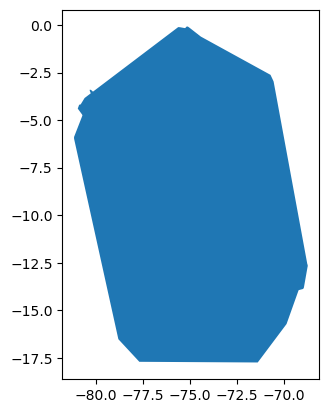

In [71]:
tipoReserva.convex_hull.plot()

In [96]:
tipoReserva_hulls = tipoReserva.convex_hull.to_frame()
tipoReserva_hulls['areaNacional']=['Bosque de Protección', 'Coto de Caza', 'Parque Nacional', 'Refugio de Vida Silvestre',
                                  'Reserva Comunal', 'Reserva Nacional', 'Reserva Paisajistica', 'Santuario Histórico ',
                                  'Santuario Nacional']
tipoReserva_hulls.rename(columns={0:'geometry'},inplace=True)
tipoReserva_hulls = tipoReserva.set_geometry('geometry')
tipoReserva_hulls.crs = "EPSG:24891"

# mostramos el "hull" de "tipoReserva"
tipoReserva_hulls

,geometry,areaNacional
0,"MULTIPOLYGON (((-76.219 -13.044, -76.219 -13.0...",Bosque de Protección
1,"MULTIPOLYGON (((-78.441 -7.256, -78.440 -7.256...",Coto de Caza
2,"MULTIPOLYGON (((-77.308 -9.889, -77.332 -9.836...",Parque Nacional
3,"MULTIPOLYGON (((-76.992 -12.201, -76.992 -12.2...",Refugio de Vida Silvestre
4,"MULTIPOLYGON (((-71.084 -12.584, -71.082 -12.5...",Reserva Comunal
5,"MULTIPOLYGON (((-77.646 -11.293, -77.646 -11.2...",Reserva Nacional
6,"MULTIPOLYGON (((-72.476 -14.760, -72.476 -14.7...",Reserva Paisajistica
7,"MULTIPOLYGON (((-72.506 -13.095, -72.506 -13.0...",Santuario Histórico
8,"MULTIPOLYGON (((-71.834 -17.162, -71.834 -17.1...",Santuario Nacional


In [97]:
distance_sysHull_aire = tipoReserva_hulls.set_index('areaNacional').geometry.apply\
(lambda g: mediumAirports.set_index('name').geometry.distance(g)/1000).\
sort_index(axis=0).sort_index(axis=1)

distance_sysHull_aire

name,Air Force Captain Jose A Quinones Gonzales International Airport,Air Force Colonel Alfredo Mendivil Duarte Airport,Alferez Fap David Figueroa Fernandini Airport,Caballococha Airport,Cadete FAP Guillermo Del Castillo Paredes Airport,Cap FAP David Abenzur Rengifo International Airport,Capitan FAP Carlos Martinez De Pinillos International Airport,Capitán FAP Guillermo Concha Iberico International Airport,Captain Pedro Canga Rodríguez International Airport,Captain Renán Elías Olivera International Airport,...,Inca Manco Capac International Airport,Juan Simons Vela Airport,Juanjui Airport,Maria Reiche Neuman Airport,Mayor General FAP Armando Revoredo Iglesias Airport,Moises Benzaquen Rengifo Airport,Padre Aldamiz International Airport,Rodríguez Ballón International Airport,Shumba Airport,Teniente General Gerardo Pérez Pinedo Airport
areaNacional,,,,,,,,,,,,,,,,,,,,,
Bosque de Protección,1372.525274,1102.043033,1213.210085,2124.670628,1528.270003,1453.084752,1254.380486,1529.443305,1714.121356,889.340977,...,1383.049486,1537.229395,1445.237715,930.096912,1374.603435,1601.968663,1600.606436,1207.104966,1528.988355,1313.547959
Coto de Caza,1372.524762,1102.044784,1213.210866,2124.671641,1528.270297,1453.085657,1254.380261,1529.442528,1714.120581,889.342600,...,1383.052180,1537.229473,1445.238002,930.098626,1374.603293,1601.968948,1600.608421,1207.107811,1528.988030,1313.549402
Parque Nacional,1372.519655,1102.035803,1213.203860,2124.664128,1528.264258,1453.078376,1254.374784,1529.437789,1714.115839,889.333905,...,1383.043533,1537.223650,1445.231970,930.089646,1374.597716,1601.962917,1600.599495,1207.099261,1528.982677,1313.541029
Refugio de Vida Silvestre,1372.526526,1102.045010,1213.211862,2124.672477,1528.271610,1453.086568,1254.381875,1529.444422,1714.122474,889.342971,...,1383.052131,1537.230916,1445.239319,930.098934,1374.604862,1601.970266,1600.608782,1207.107569,1528.989697,1313.549922
Reserva Comunal,1372.519545,1102.037730,1213.204290,2124.664902,1528.264130,1453.078997,1254.374667,1529.437697,1714.115747,889.335500,...,1383.045387,1537.223527,1445.231842,930.091986,1374.597597,1601.962789,1600.602056,1207.100853,1528.982562,1313.542383
Reserva Nacional,1372.521454,1102.038732,1213.205985,2124.666545,1528.265939,1453.080658,1254.376559,1529.439578,1714.117628,889.336773,...,1383.044258,1537.225376,1445.233653,930.092622,1374.599480,1601.964601,1600.601895,1207.099605,1528.984466,1313.543842
Reserva Paisajistica,1372.531080,1102.044092,1213.214235,2124.674395,1528.274870,1453.088702,1254.385995,1529.449349,1714.127399,889.342938,...,1383.048289,1537.234544,1445.242594,930.096862,1374.608849,1601.973543,1600.606081,1207.103584,1528.993972,1313.550543
Santuario Histórico,1372.526758,1102.043215,1213.212168,2124.672792,1528.271891,1453.086878,1254.382125,1529.444633,1714.122685,889.341944,...,1383.047942,1537.231185,1445.239600,930.096148,1374.605117,1601.970547,1600.605460,1207.103300,1528.989941,1313.549477
Santuario Nacional,1372.523907,1102.042344,1213.209975,2124.670758,1528.269405,1453.084769,1254.379389,1529.441696,1714.119749,889.341015,...,1383.047293,1537.228587,1445.237110,930.095349,1374.602417,1601.968057,1600.604697,1207.102680,1528.987162,1313.548319


In [98]:
# chancamos el antinuo "mins"
mins = distance_sysHull_aire.idxmin(axis="columns")
mins

areaNacional
Bosque de Protección         Captain Renán Elías Olivera International Airport
Coto de Caza                 Captain Renán Elías Olivera International Airport
Parque Nacional              Captain Renán Elías Olivera International Airport
Refugio de Vida Silvestre    Captain Renán Elías Olivera International Airport
Reserva Comunal              Captain Renán Elías Olivera International Airport
Reserva Nacional             Captain Renán Elías Olivera International Airport
Reserva Paisajistica         Captain Renán Elías Olivera International Airport
Santuario Histórico          Captain Renán Elías Olivera International Airport
Santuario Nacional           Captain Renán Elías Olivera International Airport
dtype: object

In [99]:
# ploteamos
base = tipoReserva_hulls.explore()
mediumAirports[mediumAirports.name.isin(mins)].explore(m=base,color='red',marker_kwds=dict(radius=10))
mediumAirports[~mediumAirports.name.isin(mins)].explore(m=base,color='blue',marker_kwds=dict(radius=5))

In [100]:
# EJERCICIO N°4:

In [101]:
# recordamos:
distance_areUrbNac_aire

name,Air Force Captain Jose A Quinones Gonzales International Airport,Air Force Colonel Alfredo Mendivil Duarte Airport,Alferez Fap David Figueroa Fernandini Airport,Caballococha Airport,Cadete FAP Guillermo Del Castillo Paredes Airport,Cap FAP David Abenzur Rengifo International Airport,Capitan FAP Carlos Martinez De Pinillos International Airport,Capitán FAP Guillermo Concha Iberico International Airport,Captain Pedro Canga Rodríguez International Airport,Captain Renán Elías Olivera International Airport,...,Inca Manco Capac International Airport,Juan Simons Vela Airport,Juanjui Airport,Maria Reiche Neuman Airport,Mayor General FAP Armando Revoredo Iglesias Airport,Moises Benzaquen Rengifo Airport,Padre Aldamiz International Airport,Rodríguez Ballón International Airport,Shumba Airport,Teniente General Gerardo Pérez Pinedo Airport
areaNacional,,,,,,,,,,,,,,,,,,,,,
Bosque de Protección,1372.525274,1102.043033,1213.210085,2124.670628,1528.270003,1453.084752,1254.380486,1529.443305,1714.121356,889.340977,...,1383.049486,1537.229395,1445.237715,930.096912,1374.603435,1601.968663,1600.606436,1207.104966,1528.988355,1313.547959
Coto de Caza,1372.524762,1102.044784,1213.210866,2124.671641,1528.270297,1453.085657,1254.380261,1529.442528,1714.120581,889.342600,...,1383.052180,1537.229473,1445.238002,930.098626,1374.603293,1601.968948,1600.608421,1207.107811,1528.988030,1313.549402
Parque Nacional,1372.519655,1102.035803,1213.203860,2124.664128,1528.264258,1453.078376,1254.374784,1529.437789,1714.115839,889.333905,...,1383.043533,1537.223650,1445.231970,930.089646,1374.597716,1601.962917,1600.599495,1207.099261,1528.982677,1313.541029
Refugio de Vida Silvestre,1372.526526,1102.045010,1213.211862,2124.672477,1528.271610,1453.086568,1254.381875,1529.444422,1714.122474,889.342971,...,1383.052131,1537.230916,1445.239319,930.098934,1374.604862,1601.970266,1600.608782,1207.107569,1528.989697,1313.549922
Reserva Comunal,1372.519545,1102.037730,1213.204290,2124.664902,1528.264130,1453.078997,1254.374667,1529.437697,1714.115747,889.335500,...,1383.045387,1537.223527,1445.231842,930.091986,1374.597597,1601.962789,1600.602056,1207.100853,1528.982562,1313.542383
Reserva Nacional,1372.521454,1102.038732,1213.205985,2124.666545,1528.265939,1453.080658,1254.376559,1529.439578,1714.117628,889.336773,...,1383.044258,1537.225376,1445.233653,930.092622,1374.599480,1601.964601,1600.601895,1207.099605,1528.984466,1313.543842
Reserva Paisajistica,1372.531080,1102.044092,1213.214235,2124.674395,1528.274870,1453.088702,1254.385995,1529.449349,1714.127399,889.342938,...,1383.048289,1537.234544,1445.242594,930.096862,1374.608849,1601.973543,1600.606081,1207.103584,1528.993972,1313.550543
Santuario Histórico,1372.526758,1102.043215,1213.212168,2124.672792,1528.271891,1453.086878,1254.382125,1529.444633,1714.122685,889.341944,...,1383.047942,1537.231185,1445.239600,930.096148,1374.605117,1601.970547,1600.605460,1207.103300,1528.989941,1313.549477
Santuario Nacional,1372.523907,1102.042344,1213.209975,2124.670758,1528.269405,1453.084769,1254.379389,1529.441696,1714.119749,889.341015,...,1383.047293,1537.228587,1445.237110,930.095349,1374.602417,1601.968057,1600.604697,1207.102680,1528.987162,1313.548319


In [124]:
# obtener un valor (puede ser cualquier valor)
distance_areUrbNac_aire.loc['Reserva Comunal'].min()

889.3355001899203

In [125]:
minMts = distance_areUrbNac_aire.loc['Reserva Comunal'].min()*1000

#the buffer is a polygon:
areasUrbanasNacionalesRenombrada[areasUrbanasNacionalesRenombrada.areaNacional=='Reserva Comunal'].buffer(distance = minMts)

GeoSeries([], dtype: geometry)

In [127]:
# vemos el buffer:
tipoReserva_proyectado = tipoReserva.to_crs(epsg=24891)
nueva_distancia = minMts * 0.4
bufferAlrededorDeBosqueDeProteccion = tipoReserva_proyectado[tipoReserva_proyectado.areaNacional=='Reserva Comunal'].buffer(distance = nueva_distancia)
bufferComoBase = bufferAlrededorDeBosqueDeProteccion.explore(color='red')
tipoReserva[tipoReserva.areaNacional=='Reserva Comunal'].explore(m=bufferComoBase,color='blue',style_kwds={'weight':1})

In [128]:
small_airports=airports[airports.kind=='small_airport']

# ploteamos
areasUrbanasNacionalesRenombrada[areasUrbanasNacionalesRenombrada.areaNacional=='Reserva Comunal'].explore(m=bufferComoBase,color='blue',style_kwds={'weight':0.5})
small_airports.explore(m=bufferComoBase,color='black')

IndexError: list index out of range